<a href="https://colab.research.google.com/github/pavants4/ML-EDA-Projects/blob/main/notebook3a73217e18.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ** Music Generation**


## *🔧 Setup*

In [1]:
!sudo apt-get install fluidsynth -y
!pip install midi2audio
!pip install music21
!pip install pedalboard


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  fluid-soundfont-gm libevdev2 libfluidsynth3 libgudev-1.0-0 libinput-bin
  libinput10 libinstpatch-1.0-2 libmd4c0 libmtdev1 libqt5core5a libqt5dbus5
  libqt5gui5 libqt5network5 libqt5svg5 libqt5widgets5 libwacom-bin
  libwacom-common libwacom9 libxcb-icccm4 libxcb-image0 libxcb-keysyms1
  libxcb-render-util0 libxcb-util1 libxcb-xinerama0 libxcb-xinput0 libxcb-xkb1
  libxkbcommon-x11-0 qsynth qt5-gtk-platformtheme qttranslations5-l10n
  timgm6mb-soundfont
Suggested packages:
  fluid-soundfont-gs qt5-image-formats-plugins qtwayland5 jackd
The following NEW packages will be installed:
  fluid-soundfont-gm fluidsynth libevdev2 libfluidsynth3 libgudev-1.0-0
  libinput-bin libinput10 libinstpatch-1.0-2 libmd4c0 libmtdev1 libqt5core5a
  libqt5dbus5 libqt5gui5 libqt5network5 libqt5svg5 libqt5widgets5 libwacom-bin
  libwacom-common libwacom9 libx

In [2]:
import zipfile
import os

# Path to the uploaded zip file in Colab's session storage
zip_file_path = '/content/archive (4).zip'

# Directory to extract to (create a new folder named classical midi)
extract_to_dir = '/content/classical midi/'

# Create the target directory if it doesn't exist
os.makedirs(extract_to_dir, exist_ok=True)

# Unzip the file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to_dir)

print("Extraction complete.")


Extraction complete.


In [3]:
from music21 import corpus, converter, instrument, note, stream, chord, duration, tempo
from keras.layers import LSTM, Input, Dropout, Dense, Activation, Embedding, Concatenate, Reshape
from keras.layers import Flatten, RepeatVector, Permute, TimeDistributed
from tensorflow.keras.optimizers import RMSprop
from keras.layers import Multiply, Lambda, Softmax
import keras.backend as K
from keras.models import Model
from IPython.display import Image, Audio
from midi2audio import FluidSynth
import matplotlib.pyplot as plt
import collections
import numpy as np
import random
import glob
import pickle
import keras
import time
import os

import warnings
warnings.filterwarnings('ignore')

random.seed(42)

In [4]:
music_files = [ele for ele in glob.glob('/content/classical midi/*/*')]
print("A random song file example: ", random.sample(music_files, 1))
print("Number of songs are:", len(music_files))

A random song file example:  ['/content/classical midi/beeth/beethoven_opus10_1.mid']
Number of songs are: 295


## *Processing*

In [5]:
'''
def round_chord_durations(number):
    if(number>1.25):
        return 2
    if(number>.30):
        return 1.25
    if(number>.10):
        return 0.3
    return 0.1

def get_processed_chords_from_music_files(music_files):
    chords = []
    for file_number, filename in enumerate(music_files):
        chords.append(converter.parse(filename).chordify())
        if(file_number%10==0):
            print(f"Completed processing of {round(file_number/len(music_files)*100, 2)}% of files")

    processed_chords = []
    for i, chord_metadata in enumerate(chords):

        for element in chord_metadata.flat:
            if isinstance(element, chord.Chord):
                chord_duration = round_chord_durations(element.duration.quarterLength)
                chord_name = ".".join([n.nameWithOctave for n in element.pitches])
                processed_chords.append((chord_name, chord_duration))

    pickle.dump(processed_chords, open("chords.data", "wb"))
    return processed_chords

try:
    open("chords.data", "rb")
    processed_chords = pickle.load(open("chords.data", "rb"))
except:
    processed_chords = get_processed_chords_from_music_files(music_files)

print("The first 20 processed chords are:", processed_chords[:20])
print("Total number of chords played in our dataset:", len(processed_chords))

'''
import joblib
processed_chords = joblib.load('processed_chords.pkl')

In [6]:

def get_music_midi_filename_from_chords(input_chords):
    midi_stream = stream.Stream()

    for note_pattern, duration_pattern in input_chords:
        notes_in_chord = note_pattern.split('.')

        chord_notes = []
        for current_note in notes_in_chord:
            new_note = note.Note(current_note)
            new_note.duration = duration.Duration(duration_pattern)
            new_note.storedInstrument = instrument.Violoncello()
            chord_notes.append(new_note)
        new_chord = chord.Chord(chord_notes)

        midi_stream.append(new_chord)

        new_tempo = tempo.MetronomeMark(number=50)

        midi_stream.append(new_tempo)

    midi_stream = midi_stream.chordify()
    timestr = time.strftime("%Y%m%d-%H%M%S")
    new_file = 'output-' + timestr + '.mid'
    return midi_stream.write('midi', fp=new_file)

print("Generating music from our processed chords...")
proccessed_chords_to_midi_sample = get_music_midi_filename_from_chords(processed_chords[210:230])
FluidSynth().midi_to_audio(proccessed_chords_to_midi_sample, "music.wav")

Audio("music.wav")

Generating music from our processed chords...


In [7]:
def data_summary(chord_data):
    count = collections.Counter(chord_data)
    print("Total number of chords in data:", len(chord_data))
    print("Unique types of chords in data:", len(count))
    print("Count of most common chord:", max(count.values()))
    print("Number of chords that only occur once:", collections.Counter(count.values())[1])
    print("5 random samples from dataset", random.sample(chord_data, 5))

data_summary(processed_chords)

Total number of chords in data: 364712
Unique types of chords in data: 73937
Count of most common chord: 1637
Number of chords that only occur once: 32949
5 random samples from dataset [('B4.E-5.F#5.B5', 1.25), ('F4.G4.B-4', 0.3), ('E5', 0.3), ('G4.G5', 0.3), ('G#2.F#4.E-5', 0.3)]


In [8]:
def simplify_data(data):
    simplify_chord_data = []
    for chord_name, chord_duration in data:
        cleaned_chord = ""

        if("-" in chord_name):
            chord_name = chord_name.replace("-", "")

        split_chord = chord_name.split(".")
        split_chord.sort(reverse=True)

        for split in split_chord:

            processed_note = split[0] # A,B,C etc.

            if(processed_note not in cleaned_chord): # choose only one note of each type in a chord
                if(split[-1] in "12"):
                    processed_note += "2"
                else:
                    processed_note += split[-1]
                cleaned_chord += processed_note+"."

        if("." == cleaned_chord[-1]):
            cleaned_chord = cleaned_chord[:len(cleaned_chord)-1]

        simplify_chord_data.append((cleaned_chord, chord_duration))

    return simplify_chord_data

print("-"*80)
print("Example ouput for simplify_data()")

input_data = [('C2.D4', 0.3), ('F#1.G#1.C4.F4.A4.C5', 0.3), ('D2.A2.D3.F3.A3.F4', 2), ('A3.B3', 1.25), ('A1.A2.A4.F5.A5', 0.3)]
output_data = simplify_data(input_data)
print("Input:", input_data)
print("Output:", output_data)

--------------------------------------------------------------------------------
Example ouput for simplify_data()
Input: [('C2.D4', 0.3), ('F#1.G#1.C4.F4.A4.C5', 0.3), ('D2.A2.D3.F3.A3.F4', 2), ('A3.B3', 1.25), ('A1.A2.A4.F5.A5', 0.3)]
Output: [('D4.C2', 0.3), ('G2.F4.C5.A4', 0.3), ('F4.D3.A3', 2), ('B3.A3', 1.25), ('F5.A5', 0.3)]


In [9]:
cleaned_chord_data = simplify_data(processed_chords)
data_summary(cleaned_chord_data)

Total number of chords in data: 364712
Unique types of chords in data: 20389
Count of most common chord: 4326
Number of chords that only occur once: 6534
5 random samples from dataset [('C3.B6', 0.3), ('G5.C5.B4', 0.3), ('C4', 0.3), ('E5.C5', 0.3), ('F3.C4', 0.3)]


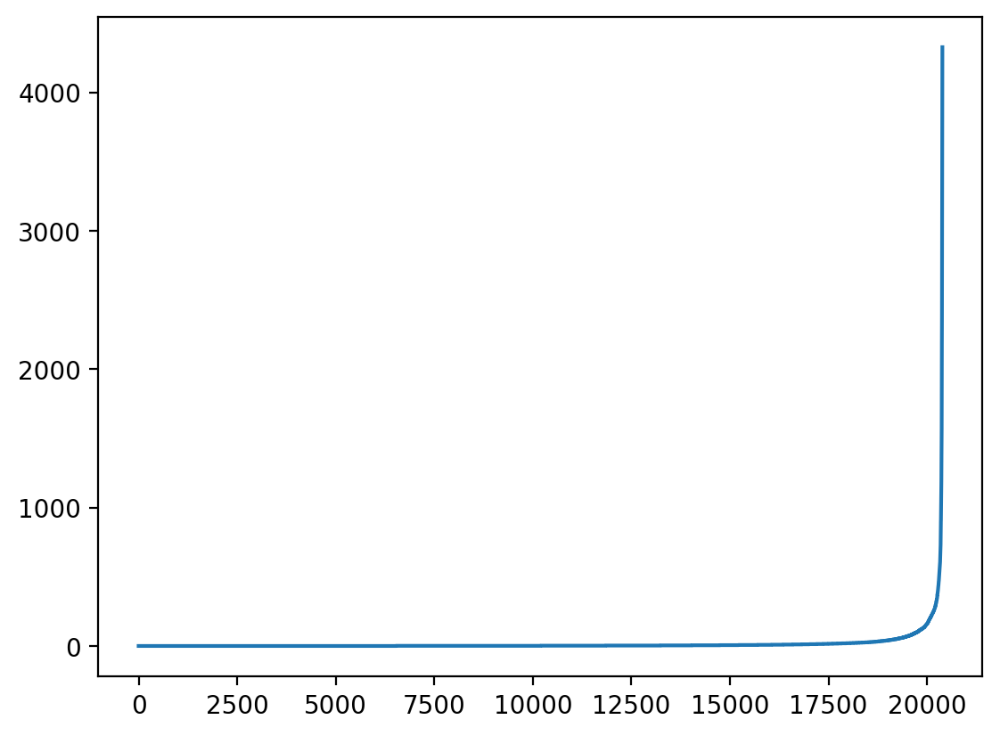

In [10]:
from collections import Counter
plt.plot(sorted(Counter(cleaned_chord_data).values()))

In [11]:
pruned_chord_data = []
count = collections.Counter(cleaned_chord_data)

for c in cleaned_chord_data:
    if(count[c]>200):
        pruned_chord_data.append(c)

data_summary(pruned_chord_data)

Total number of chords in data: 171738
Unique types of chords in data: 315
Count of most common chord: 4326
Number of chords that only occur once: 0
5 random samples from dataset [('F3.D4', 0.3), ('G2', 0.3), ('G4.C4', 1.25), ('G3.E5', 0.3), ('G4', 0.3)]


In [12]:
pruned_chord_data_to_midi_sample = get_music_midi_filename_from_chords(pruned_chord_data[1000:1020])
FluidSynth().midi_to_audio(pruned_chord_data_to_midi_sample, "music.wav")

Audio("music.wav")

In [13]:
c = list(set(pruned_chord_data))
mapping_from_id = dict(zip(range(len(c)), c))
mapping_to_id = dict(zip(c, range(len(c))))
chord_id_data = [mapping_to_id[ele] for ele in pruned_chord_data]

data_summary(chord_id_data)

Total number of chords in data: 171738
Unique types of chords in data: 315
Count of most common chord: 4326
Number of chords that only occur once: 0
5 random samples from dataset [224, 73, 47, 303, 171]


In [14]:
notes_network_input = []
notes_network_output = []
seq_len = 32
n_notes = len(mapping_from_id)

# create input sequences and the corresponding outputs
for i in range(len(chord_id_data) - seq_len):
    notes_sequence_in = chord_id_data[i:i + seq_len]
    notes_sequence_out = chord_id_data[i + seq_len]
    notes_network_input.append(notes_sequence_in)
    notes_network_output.append(notes_sequence_out)

n_patterns = len(notes_network_input)

# reshape the input into a format compatible with LSTM layers
network_input = np.reshape(notes_network_input, (n_patterns, seq_len, 1))/n_notes

from tensorflow.keras.utils import to_categorical

network_output = to_categorical(notes_network_output, num_classes=n_notes)

print("Input shape", network_input.shape)
print("Output shape", network_output.shape)

Input shape (171706, 32, 1)
Output shape (171706, 315)


In [15]:
from keras import Sequential
from tensorflow.keras.optimizers import Adamax
def create_network(X, y):
    #Initialising the Model
    model = Sequential()
    #Adding layers
    model.add(LSTM(512, input_shape=(32, 1), return_sequences=True))
    model.add(Dropout(0.1))
    model.add(LSTM(256))
    model.add(Dense(256))
    model.add(Dropout(0.1))
    model.add(Dense(y.shape[1], activation='softmax'))
    #Compiling the model for training
    opt = Adamax(learning_rate=0.01)
    model.compile(loss='categorical_crossentropy', optimizer=opt)
    return model

In [16]:
model = create_network(network_input, network_output)

In [17]:
model.fit(network_input, network_output, batch_size=64, epochs=2)

Epoch 1/2
2683/2683 [==============================] - 2307s 857ms/step - loss: 5.3716
Epoch 2/2
2683/2683 [==============================] - 2275s 848ms/step - loss: 5.3577


## 🥳 *Finally we trained our model!!!! Time to generate a random song using our LSTM*

In [18]:
joblib.dump(model,'model.pkl')

['model.pkl']

In [24]:
generated_music_id = chord_id_data[:32]
n_notes = len(mapping_from_id)

for i in range(100):
    model_input = generated_music_id[-32:]

    model_input = np.reshape(model_input, (1,32,1))/n_notes

    model_output = model.predict(model_input)
    model_output = model_output.argmax(axis=-1)[0]

    generated_music_id.append(model_output)

generated_music_id = generated_music_id[32:] # remove the random part of the song
print(generated_music_id)

1/1 [==============================] - 0s 88ms/step
[47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47]


In [25]:
generated_music = [mapping_from_id[ele] for ele in generated_music_id]
print("Generated music:", generated_music)

Generated music: [('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 0.3), ('C5', 

In [28]:
generated_music_to_midi = get_music_midi_filename_from_chords(generated_music)
FluidSynth().midi_to_audio(generated_music_to_midi, "music.wav")

print("\n\nThe music we created 🎵 \n")
Audio("music.wav")



The music we created 🎵 



In [22]:
from pedalboard import Pedalboard, Chorus, Reverb
from pedalboard.io import AudioFile

# Read in a whole audio file:
with AudioFile('music.wav') as f:
  audio = f.read(f.frames)
  samplerate = f.samplerate

# Make a Pedalboard object, containing multiple plugins:
board = Pedalboard([Reverb(room_size=0.6)])

# Run the audio through this pedalboard!
effected = board(audio, samplerate)

# Write the audio back as a wav file:
with AudioFile('processed-music.wav', 'w', samplerate, effected.shape[0]) as f:
  f.write(effected)

In [27]:
print("\n\nMusic after some reverb  \n")
Audio("processed-music.wav")



Music after some reverb  

